# Scan-to-BIM Bootcamp Week 3

*This session will introduce point cloud processing algorithms such as downsampling and filtering, histograms, normal, curvature, line-fitting, plane-fitting, and Euclidean clustering.*

The assignment for this notebook is to use geometric operations to process a laser-scanned building point cloud.

# 1. Point Cloud Data Loading and Visualization

In [1]:
# Install the Open3D library
# This step is needed because Open3D is not a standard library included in Google Colab
!pip install open3d

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 408.6 MB 27 kB/s 
     |████████████████████████████████| 1.1 MB 61.8 MB/s 
     |████████████████████████████████| 8.8 MB 43.5 MB/s 
     |████████████████████████████████| 3.1 MB 43.2 MB/s 
     |████████████████████████████████| 54 kB 2.6 MB/s 
     |████████████████████████████████| 9.7 MB 45.9 MB/s 
     |████████████████████████████████| 423 kB 71.6 MB/s 
     |████████████████████████████████| 344 kB 73.9 MB/s 
     |████████████████████████████████| 1.6 MB 43.1 MB/s 
     |████████████████████████████████| 1.2 MB 56.4 MB/s 
     |████████████████████████████████| 80 kB 9.0 MB/s 
     |████████████████████████████████| 55 kB 3.3 MB/s 
     |████████████████████████████████| 271 kB 61.6 MB/s 
     |████████████████████████████████| 59 kB 5.5 MB/s 
     |████████████████████████████████| 133 kB 58.6 MB/s 
     |████████████████████████████████|

In [2]:
# Mount a Google Drive folder so that the data files can be accessed
from google.colab import drive
from google.colab import files
import sys
drive.mount('/content/drive', force_remount=True)
%cd drive/MyDrive/Scan-to-BIM Bootcamp/Week 3/
sys.path.insert(0,'/content/drive/MyDrive/Scan-to-BIM Bootcamp/Week 3/')

Mounted at /content/drive
/content/drive/MyDrive/Scan-to-BIM Bootcamp/Week 3


In [10]:
# Import libraries and utility functions
import open3d as o3d
import numpy as np
import matplotlib.pyplot as plt
from utils import draw_geometries

In [4]:
# Load a sample point cloud using the Open3D library
pcd_object = o3d.io.read_point_cloud("sample1.ply")
# Convert to a NumPy array for further processing
initial_pcd = np.hstack([pcd_object.points, pcd_object.colors]).astype(np.float32)
print("Point cloud dimensions are: ", initial_pcd.shape)
np.set_printoptions(precision=3, suppress=True)
print("Point cloud coordinates are:")
print(initial_pcd)

Point cloud dimensions are:  (76738, 6)
Point cloud coordinates are:
[[ 880.833 1149.219   97.833    0.514    0.533    0.557]
 [ 659.67   635.933  182.366    0.576    0.58     0.663]
 [ 659.567  635.883  182.494    0.055    0.067    0.141]
 ...
 [ 694.928  671.614  197.374    1.       1.       1.   ]
 [ 695.005  671.668  197.471    1.       1.       1.   ]
 [ 895.117  747.138  203.476    0.996    1.       1.   ]]


In [5]:
# Visualize the point cloud using a 3D web viewer
draw_geometries([pcd_object], show_axes=True)

# 2. Point cloud rotation

In [6]:
# Construct rotation matrix from a given angle

rotation_angle = -26.529492455418378 # degrees
theta = np.radians(rotation_angle)
R = np.array(((np.cos(theta), -np.sin(theta)), (np.sin(theta), np.cos(theta))))
print("Rotation matrix:")
print(R)

Rotation matrix:
[[ 0.895  0.447]
 [-0.447  0.895]]


In [7]:
# Apply rotation matrix to point cloud (x, y) coordinates

pcd_rotated = initial_pcd.copy()
pcd_rotated[:, :2] = R.dot(pcd_rotated[:, :2].T).T

In [8]:
# Visualize point cloud after rotation
pcd_object.points = o3d.utility.Vector3dVector(pcd_rotated[:, 0:3])
draw_geometries([pcd_object], show_axes=True)

# 3. Point cloud filtering

Text(0.5, 1.0, 'Histogram in z axis')

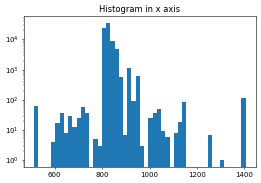

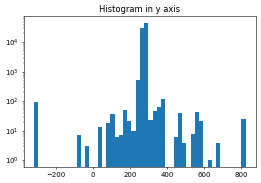

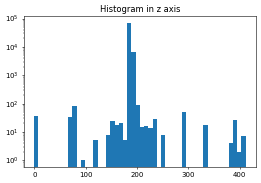

In [12]:
# Visualize histogram of the point cloud coordinates
plt.rcParams['figure.dpi'] = 50
plt.figure()
plt.hist(pcd_rotated[:, 0], bins=50, log=True)
plt.title('Histogram in x axis')

plt.figure()
plt.hist(pcd_rotated[:, 1], bins=50, log=True)
plt.title('Histogram in y axis')

plt.figure()
plt.hist(pcd_rotated[:, 2], bins=50, log=True)
plt.title('Histogram in z axis')

In [14]:
print(pcd_rotated[:, 0] > x_range[0])

[ True  True  True ...  True  True  True]


In [17]:
# Perform spatial filtering of the point cloud according to a specified range in all 3 axes

x_range = [811.629, 823.261]
y_range = [270.679, 283.000]
z_range = [182.422, 186.92]

mask = (pcd_rotated[:, 0] > x_range[0]) &  \
      (pcd_rotated[:, 0] < x_range[1]) & \
      (pcd_rotated[:, 1] > y_range[0]) &  \
      (pcd_rotated[:, 1] < y_range[1]) & \
      (pcd_rotated[:, 2] > z_range[0]) &  \
      (pcd_rotated[:, 2] < z_range[1])

pcd_filtered = pcd_rotated[mask]
print("Filtered point cloud from", len(pcd_rotated),'points to',len(pcd_filtered),'points')

Filtered point cloud from 76738 points to 48994 points


In [18]:
# Visualize point cloud after filtering
pcd_object.points = o3d.utility.Vector3dVector(pcd_filtered[:, 0:3])
pcd_object.colors = o3d.utility.Vector3dVector(pcd_filtered[:, 3:6])
draw_geometries([pcd_object], show_axes=True)

# 4. Euclidean clustering

In [22]:
# Extract points from a single room without walls, ceiling, and floor

x_range = [812.2, 822]
y_range = [271.7, 278]
z_range = [182.75, 186.5]

mask = (pcd_filtered[:, 0] > x_range[0]) &  \
      (pcd_filtered[:, 0] < x_range[1]) & \
      (pcd_filtered[:, 1] > y_range[0]) &  \
      (pcd_filtered[:, 1] < y_range[1]) & \
      (pcd_filtered[:, 2] > z_range[0]) &  \
      (pcd_filtered[:, 2] < z_range[1])

room_points = pcd_filtered[mask]

pcd_object.points = o3d.utility.Vector3dVector(room_points[:, 0:3])
pcd_object.colors = o3d.utility.Vector3dVector(room_points[:, 3:6])
draw_geometries([pcd_object], show_axes=True)

In [30]:
cluster_object = o3d.geometry.PointCloud()
cluster_object.points = o3d.utility.Vector3dVector(room_points[:, :3])
cluster_label = np.array(cluster_object.cluster_dbscan(eps=0.3, min_points=0, print_progress=False))

num_clusters_found = cluster_label.max() + 1
print('Found %d clusters from %d points'%(num_clusters_found, len(room_points)))

Found 33 clusters from 7557 points


In [32]:
# For each cluster of points, compute the number of points, length, width, and height
for i in range(num_clusters_found):
  cluster_points = room_points[cluster_label == i]
  num_cluster_points = len(cluster_points)
  length = cluster_points[:,0].max() - cluster_points[:,0].min()
  width = cluster_points[:,1].max() - cluster_points[:,1].min()
  height = cluster_points[:,2].max() - cluster_points[:,2].min()
  print('Cluster %d: %d points (length=%.2f width=%.2f height=%.2f)' % (i, num_cluster_points, length, width, height))


Cluster 0: 194 points (length=0.56 width=1.34 height=1.58)
Cluster 1: 4926 points (length=8.91 width=6.30 height=3.17)
Cluster 2: 85 points (length=0.89 width=0.50 height=0.70)
Cluster 3: 419 points (length=2.92 width=0.68 height=1.24)
Cluster 4: 5 points (length=0.13 width=0.10 height=0.15)
Cluster 5: 7 points (length=0.15 width=0.16 height=0.20)
Cluster 6: 6 points (length=0.13 width=0.10 height=0.19)
Cluster 7: 52 points (length=0.82 width=0.53 height=0.66)
Cluster 8: 1 points (length=0.00 width=0.00 height=0.00)
Cluster 9: 19 points (length=1.54 width=0.08 height=0.23)
Cluster 10: 247 points (length=5.06 width=0.45 height=0.20)
Cluster 11: 973 points (length=3.46 width=3.85 height=0.36)
Cluster 12: 234 points (length=5.06 width=0.41 height=0.18)
Cluster 13: 18 points (length=0.45 width=0.35 height=0.25)
Cluster 14: 319 points (length=1.18 width=3.71 height=0.68)
Cluster 15: 1 points (length=0.00 width=0.00 height=0.00)
Cluster 16: 1 points (length=0.00 width=0.00 height=0.00)
Clust

In [33]:
# Visualize the clustering results, where a random unique color is assigned to each
# cluster of points
pcd_object.points = o3d.utility.Vector3dVector(room_points[:, :3])
color_sample_state = np.random.RandomState(0)
obj_color = color_sample_state.random((np.max(cluster_label)+1,3))
pcd_object.colors = o3d.utility.Vector3dVector(obj_color[cluster_label])
draw_geometries([pcd_object])